# Version
- version comment 
- 25종을 15종으로 바꿈에 따라서,,, 해당 레이블 변환이 잘 이루어졌는지 확인하기 위한 실행 버전 

In [8]:
# libs 
from PIL import Image
import matplotlib.patches as patches
import matplotlib as mpl
from glob import glob
import xml.etree.ElementTree as elemTree
import math 
import numpy as np
import matplotlib.pyplot as plt
import os
from skimage import exposure

In [20]:
# # Level 2 Cateogry Table 


# #--------------------------------------
# level_2_table = ['Other_Ship', 
#                  'Other_Warship', 
#                  'Submarine', 
#                  'Other_Aircraft_Carrier', 
#                  'Ticonderoga',
#                  'Other_Destroyer', 
#                  'Other_Frigate', 
#                  'Patrol', 
#                  'Other_Landing', 
#                  'Commander', 
#                  'Other_Auxiliary_Ship',
#                  'Other_Merchant', 
#                  'Container_Ship', 
#                  'RoRo', 
#                  'Cargo',
#                  'Barge', 
#                  'Tugboat', 
#                  'Ferry', 
#                  'Yacht', 
#                  'Sailboat', 
#                  'Fishing_Vessel', 
#                  'Oil_Tanker', 
#                  'Hovercraft',
#                  'Motorboat',
#                  'Dock']


# This is 15 sorts of category version !!! 
level_2_table = ['Warship',
                 'Warship', 
                 'Submarine', 
                 'Other_Aircraft_Carrier', 
                 'Warship', 
                 'Warship', 
                 'Warship', 
                 'Warship', 
                 'Warship',
                 'Warship', 
                 'Warship', 
                 'Cargo', 
                 'Container_Ship', 
                 'RoRo', 
                 'Cargo',
                 'Barge', 
                 'Cargo', 
                 'Cargo', 
                 'Yacht', 
                 'Yacht', 
                 'Fishing_Vessel', 
                 'Oil_Tanker', 
                 'Hovercraft',
                 'Motorboat',
                 'Dock']

In [22]:
set(level_2_table)

{'Barge',
 'Cargo',
 'Container_Ship',
 'Dock',
 'Fishing_Vessel',
 'Hovercraft',
 'Motorboat',
 'Oil_Tanker',
 'Other_Aircraft_Carrier',
 'RoRo',
 'Submarine',
 'Warship',
 'Yacht'}

In [23]:
len(set(level_2_table))

13

In [10]:
level_2_table[19]

'Yacht'

In [11]:
# def extract values from ann 
def extract_values(tree):
    
    a = tree.findall(".//object")
    boxes = []
    for q in range(len(a)):
        category_level_ = a[q].findall("level_2")[0].text
        polygon_ = [float(a[q].findall("polygon")[0][i].text) for i in range(8)]
        
        a_box = polygon_ + [category_level_] 
        boxes.append( a_box )
    return boxes


# 1. Visualize 
- Annotations 파일목록에 대한 시각화

100001359.bmp
002034.bmp
003354.bmp
100000634.bmp
003139.bmp
000342.bmp
100000944.bmp
1441__2027_0.bmp
100000658.bmp
000785.bmp


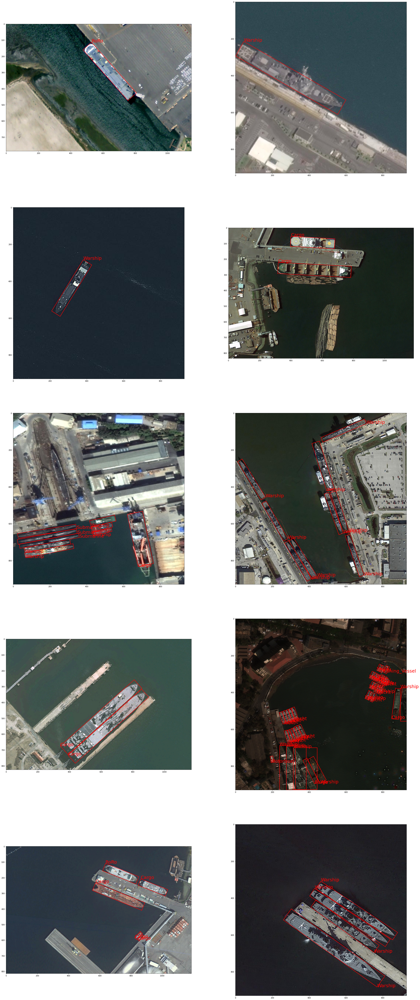

In [15]:
from matplotlib.patches import Polygon
import matplotlib.pyplot as plt
from PIL import Image

# Annotation file list
anno_list = glob("/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/*")


def visualize_category(anno_list):
    # Figure and ax
    rows = 5
    cols = 2 
    fig, ax = plt.subplots(rows,cols, figsize=(40,100) )

    cnt = 0
    for row in range(rows):
        for col in range(cols):
            
            # Set annotation          
            ann_file = anno_list[cnt]
            ann_file_endfix = ann_file.split("/")[-1].replace(".xml",".bmp")
            print(ann_file_endfix)
            img_root = "/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/JPEGImages"
            img_file = os.path.join(img_root, ann_file_endfix)

            # Set Image #-===> 아 이거 반대로 해야뎀. test image 가 안에 껴져 있어가지고 ! 
            img_ = Image.open(img_file)
            ax[row,col].imshow(img_)


            # Ploygon
            tree = elemTree.parse(ann_file)
            results = extract_values(tree)

            for i,result in enumerate(results):
                poly_template = [(result[0] ,result[1]), (result[2] ,result[3]), (result[4] ,result[5]) ,(result[6] ,result[7])]
                vertices = Polygon(poly_template, closed=True, edgecolor='r', linewidth=2,facecolor='none')
                
                ship_number = result[8]
                ship_type = level_2_table[int(ship_number)-1]

                ax[row,col].text(result[0],result[1],ship_type,fontdict={'fontsize' :25,'color':'red'} )
                ax[row,col].add_patch(vertices)
                

            '''
            fontdict : dict
                A dictionary controlling the appearance of the title text,
                the default *fontdict* is::

                    {'fontsize': rcParams['axes.titlesize'],
                    'fontweight': rcParams['axes.titleweight'],
                    'color': rcParams['axes.titlecolor'],
                    'verticalalignment': 'baseline',
                    'horizontalalignment': loc} 
            '''
            cnt +=1 

    plt.show()

#---- Exec
visualize_category(anno_list = anno_list[500:])

# 2. Category Visualize 
- 카테고리를 고른다음 선택된 카테고리를 포함하는 annotation 파일에 대한 시각화 

In [16]:
level_2_table.__len__()

25

In [17]:
level_2_table

['Warship',
 'Warship',
 'Submarine',
 'Other_Aircraft_Carrier',
 'Warship',
 'Warship',
 'Warship',
 'Warship',
 'Warship',
 'Warship',
 'Warship',
 'Cargo',
 'Container_Ship',
 'RoRo',
 'Cargo',
 'Barge',
 'Cargo',
 'Cargo',
 'Yacht',
 'Yacht',
 'Fishing_Vessel',
 'Oil_Tanker',
 'Hovercraft',
 'Motorboat',
 'Dock']

1438__920_1840.bmp
000392.bmp
2278__2665_0.bmp
004079.bmp
1217__1840_1962.bmp
000129.bmp
100001042.bmp
100001660.bmp
000047.bmp
001974.bmp


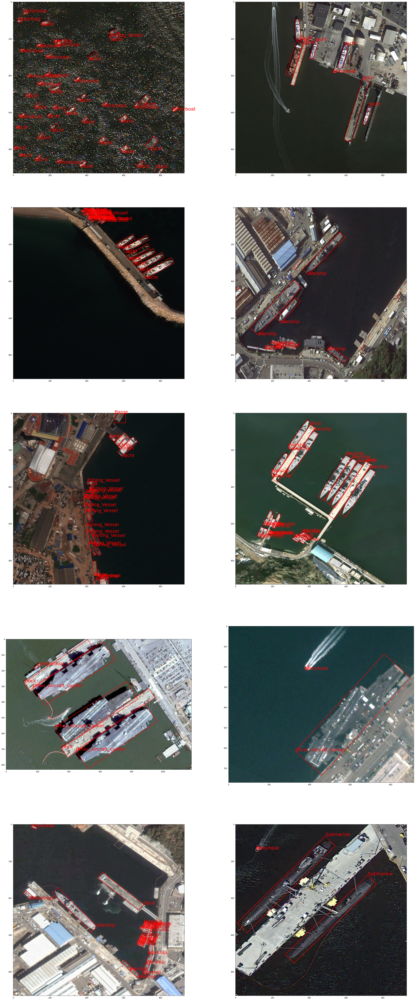

In [19]:
# choose category 
target ='Motorboat'
target_category = level_2_table.index(target) 
target_category +=1

# Annotation file list
anno_list = glob("/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/*")


from collections import defaultdict

box_per_anno = defaultdict()
for anno in anno_list:
        
    # Ploygon
    tree = elemTree.parse(anno)
    results = extract_values(tree)
    
    box_per_anno[anno] = results
    

#----------------------------------
target_annos = []
for key in box_per_anno.keys():
    values = box_per_anno[key]
    
    for v in values:
        cate_num = int(v[-1])
        
        if target_category == cate_num:
            target_annos.append(key)

target_annos = list(set(target_annos)) 


#---- exec
            
visualize_category(anno_list = target_annos[40:])

In [60]:
target_annos

['/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/100001120.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/1442__0_920.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/004650.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/004650.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/001234.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/004301.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/001773.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/001773.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/001773.xml',
 '/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Form

In [55]:
box_per_anno["/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/1702__920_0.xml"]

[[536.0, 20.0, 547.0, 26.0, 557.0, 7.0, 547.0, 1.0, '20'],
 [549.0, 24.0, 560.0, 30.0, 572.0, 7.0, 562.0, 1.0, '20'],
 [565.0, 26.0, 575.0, 31.0, 587.0, 9.0, 577.0, 4.0, '20'],
 [575.0, 32.0, 587.0, 38.0, 602.0, 10.0, 591.0, 4.0, '20'],
 [588.0, 37.0, 598.0, 43.0, 613.0, 16.0, 603.0, 10.0, '20'],
 [615.0, 45.0, 625.0, 50.0, 639.0, 24.0, 630.0, 19.0, '20'],
 [642.0, 54.0, 651.0, 59.0, 665.0, 34.0, 656.0, 29.0, '20'],
 [659.0, 57.0, 667.0, 62.0, 681.0, 39.0, 672.0, 34.0, '20'],
 [672.0, 63.0, 680.0, 68.0, 693.0, 45.0, 684.0, 40.0, '20'],
 [682.0, 66.0, 690.0, 71.0, 703.0, 50.0, 694.0, 45.0, '20'],
 [697.0, 71.0, 705.0, 76.0, 716.0, 57.0, 708.0, 52.0, '20'],
 [661.0, 97.0, 672.0, 103.0, 685.0, 82.0, 673.0, 75.0, '20'],
 [650.0, 91.0, 660.0, 97.0, 672.0, 76.0, 662.0, 70.0, '20'],
 [637.0, 87.0, 648.0, 93.0, 661.0, 71.0, 650.0, 65.0, '20'],
 [623.0, 83.0, 633.0, 89.0, 647.0, 65.0, 636.0, 60.0, '20'],
 [611.0, 79.0, 621.0, 84.0, 634.0, 62.0, 624.0, 56.0, '20'],
 [600.0, 72.0, 609.0, 77.0, 61

In [ ]:
from matplotlib.patches import Polygon
import matplotlib.pyplot as plt
from PIL import Image

# Annotation file list
anno_list = glob("/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/Annotations/*")

# Figure and ax
rows = 5
cols = 2 
fig, ax = plt.subplots(rows,cols, figsize=(40,100))

cnt = 0
for row in range(rows):
    for col in range(cols):
        
        # Set annotation          
        ann_file = anno_list[cnt]
        ann_file_endfix = ann_file.split("/")[-1].replace(".xml",".bmp")
        print(ann_file_endfix)
        img_root = "/mnt/hdd/eric/.tmp_ipy/00.Data/ShipRS_dataset/ShipRSImageNet_V1/VOC_Format/JPEGImages"
        img_file = os.path.join(img_root, ann_file_endfix)

        # Set Image #-===> 아 이거 반대로 해야뎀. test image 가 안에 껴져 있어가지고 ! 
        img_ = Image.open(img_file)
        ax[row,col].imshow(img_)


        # Ploygon
        tree = elemTree.parse(ann_file)
        results = extract_values(tree)

        for i,result in enumerate(results):
            poly_template = [(result[0] ,result[1]), (result[2] ,result[3]), (result[4] ,result[5]) ,(result[6] ,result[7])]
            vertices = Polygon(poly_template, closed=True, edgecolor='r', linewidth=2,facecolor='none')
            
            ship_number = result[8]
            ship_type = level_2_table[int(ship_number)-1]

            ax[row,col].text(result[0],result[1],ship_type,fontdict={'fontsize' :25,'color':'red'} )
            ax[row,col].add_patch(vertices)
            

        '''
        fontdict : dict
            A dictionary controlling the appearance of the title text,
            the default *fontdict* is::

                {'fontsize': rcParams['axes.titlesize'],
                'fontweight': rcParams['axes.titleweight'],
                'color': rcParams['axes.titlecolor'],
                'verticalalignment': 'baseline',
                'horizontalalignment': loc} 
        '''
        cnt +=1 

plt.show()